# 0. DATA SOURCE AND COLUMN MEANING
The Historical Weather API is based on reanalysis datasets and uses a combination of weather station, aircraft, buoy, radar, and satellite observations to create a comprehensive record of past weather conditions. These datasets are able to fill in gaps by using mathematical models to estimate the values of various weather variables. As a result, reanalysis datasets are able to provide detailed historical weather information for locations that may not have had weather stations nearby, such as rural areas or the open ocean.

`Temperature_2m`- Air temperature at 2 meters above ground

`Relative_humidity_2m`-	Relative humidity at 2 meters above ground

`Dew_point_2m`-	Dew point temperature at 2 meters above ground

`Apparent_temperature`- Apparent temperature is the perceived feels-like temperature combining wind chill factor, relative humidity and solar radiation

`pressure_msl`- hPa	Atmospheric air pressure reduced to mean sea level (msl) or pressure at surface

`surface_pressure`- Typically pressure on mean sea level is used in meteorology. `Surface pressure gets lower with increasing elevation.

`Precipitation`- Preceding hour sum	mm (inch)	Total precipitation (rain, showers, snow) sum of the preceding hour. Data is stored with a 0.1 mm precision. If precipitation data 
is summed up to monthly sums, there might be small inconsistencies with the total precipitation amount.

`Rain`- Preceding hour sum	mm (inch)	Only liquid precipitation of the preceding hour including local showers and rain from large scale systems.

`Snowfall`- Preceding hour sum	cm (inch) Snowfall amount of the preceding hour in centimeters. For the water equivalent in millimeter, divide by 7. E.g. 7 cm snow = 10 mm 
precipitation water equivalent

`Snow_depth`- Snow depth on the ground. Snow depth in ERA5-Land tends to be overestimated. As the spatial resolution for snow depth is limited, please use it with care.(meters)

`cloud_cover`-	Instant	%	Total cloud cover as an area fraction

`cloud_cover_low`-	Instant	%	Low level clouds and fog up to 2 km altitude

`cloud_cover_mid`- Mid level clouds from 2 to 6 km altitude

`cloud_cover_high`- High level clouds from 6 km altitude,

`Wind_speed_10m / wind_speed_100m`- km/h (mph, m/s, knots)	Wind speed at 10 or 100 meters above ground. Wind speed on 10 meters is the standard level.

`Wind_direction_10m / wind_direction_100m`- Wind direction at 10 or 100 meters above ground

`Wind_gusts_10m`- km/h (mph, m/s, knots)	Gusts at 10 meters above ground of the indicated hour. Wind gusts in CERRA are defined as the maximum wind gusts of the preceding hour. Please consult the ECMWF IFS documentation for more information on how wind gusts are parameterized in weather models.

<https://open-meteo.com/en/docs/historical-weather-api#hourly=temperature_2m,relative_humidity_2m,dew_point_2m,apparent_temperature,precipitation,rain,snowfall,snow_depth,weather_code,surface_pressure,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,wind_direction_100m,wind_gusts_10m>

In [34]:
#importing librarirees
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
import seaborn as sns
import plotly.express as px
from sklearn.impute import SimpleImputer
import requests
import openmeteo_requests
import requests_cache
from retry_requests import retry

`Open meteo` provides us with the code for exracting data from their API. The code is implemented below

In [9]:

# Setup the Open-Meteo API client with cache and retry on error
cache_session = requests_cache.CachedSession('.cache', expire_after = -1)
retry_session = retry(cache_session, retries = 5, backoff_factor = 0.2)
openmeteo = openmeteo_requests.Client(session = retry_session)

# Make sure all required weather variables are listed here
# The order of variables in hourly or daily is important to assign them correctly below
url = "https://archive-api.open-meteo.com/v1/archive"
params = {
	"latitude": 52.52,
	"longitude": 13.41,
	"start_date": "2021-03-01",
	"end_date": "2025-03-04",
	"hourly": ["temperature_2m", "relative_humidity_2m", "dew_point_2m", "apparent_temperature", "precipitation", "rain", "snowfall", "snow_depth", "weather_code", "pressure_msl", "surface_pressure", "cloud_cover", "cloud_cover_low", "cloud_cover_mid", "cloud_cover_high", "et0_fao_evapotranspiration", "vapour_pressure_deficit", "wind_speed_10m", "wind_speed_100m", "wind_direction_10m", "wind_direction_100m", "wind_gusts_10m", "soil_temperature_0_to_7cm", "soil_temperature_7_to_28cm", "soil_temperature_28_to_100cm", "soil_temperature_100_to_255cm", "soil_moisture_0_to_7cm", "soil_moisture_7_to_28cm", "soil_moisture_28_to_100cm", "soil_moisture_100_to_255cm"]
}
responses = openmeteo.weather_api(url, params=params)

# Process first location. Add a for-loop for multiple locations or weather models
response = responses[0]
print(f"Coordinates {response.Latitude()}°N {response.Longitude()}°E")
print(f"Elevation {response.Elevation()} m asl")
print(f"Timezone {response.Timezone()} {response.TimezoneAbbreviation()}")
print(f"Timezone difference to GMT+0 {response.UtcOffsetSeconds()} s")

# Process hourly data. The order of variables needs to be the same as requested.
hourly = response.Hourly()
hourly_temperature_2m = hourly.Variables(0).ValuesAsNumpy()
hourly_relative_humidity_2m = hourly.Variables(1).ValuesAsNumpy()
hourly_dew_point_2m = hourly.Variables(2).ValuesAsNumpy()
hourly_apparent_temperature = hourly.Variables(3).ValuesAsNumpy()
hourly_precipitation = hourly.Variables(4).ValuesAsNumpy()
hourly_rain = hourly.Variables(5).ValuesAsNumpy()
hourly_snowfall = hourly.Variables(6).ValuesAsNumpy()
hourly_snow_depth = hourly.Variables(7).ValuesAsNumpy()
hourly_weather_code = hourly.Variables(8).ValuesAsNumpy()
hourly_pressure_msl = hourly.Variables(9).ValuesAsNumpy()
hourly_surface_pressure = hourly.Variables(10).ValuesAsNumpy()
hourly_cloud_cover = hourly.Variables(11).ValuesAsNumpy()
hourly_cloud_cover_low = hourly.Variables(12).ValuesAsNumpy()
hourly_cloud_cover_mid = hourly.Variables(13).ValuesAsNumpy()
hourly_cloud_cover_high = hourly.Variables(14).ValuesAsNumpy()
hourly_wind_speed_10m = hourly.Variables(17).ValuesAsNumpy()
hourly_wind_speed_100m = hourly.Variables(18).ValuesAsNumpy()
hourly_wind_direction_10m = hourly.Variables(19).ValuesAsNumpy()
hourly_wind_direction_100m = hourly.Variables(20).ValuesAsNumpy()
hourly_wind_gusts_10m = hourly.Variables(21).ValuesAsNumpy()

hourly_data = {"date": pd.date_range(
	start = pd.to_datetime(hourly.Time(), unit = "s", utc = True),
	end = pd.to_datetime(hourly.TimeEnd(), unit = "s", utc = True),
	freq = pd.Timedelta(seconds = hourly.Interval()),
	inclusive = "left"
)}

hourly_data["temperature_2m"] = hourly_temperature_2m
hourly_data["relative_humidity_2m"] = hourly_relative_humidity_2m
hourly_data["dew_point_2m"] = hourly_dew_point_2m
hourly_data["apparent_temperature"] = hourly_apparent_temperature
hourly_data["precipitation"] = hourly_precipitation
hourly_data["rain"] = hourly_rain
hourly_data["snowfall"] = hourly_snowfall
hourly_data["snow_depth"] = hourly_snow_depth
hourly_data["weather_code"] = hourly_weather_code
hourly_data["pressure_msl"] = hourly_pressure_msl
hourly_data["surface_pressure"] = hourly_surface_pressure
hourly_data["cloud_cover"] = hourly_cloud_cover
hourly_data["cloud_cover_low"] = hourly_cloud_cover_low
hourly_data["cloud_cover_mid"] = hourly_cloud_cover_mid
hourly_data["cloud_cover_high"] = hourly_cloud_cover_high
hourly_data["wind_speed_10m"] = hourly_wind_speed_10m
hourly_data["wind_speed_100m"] = hourly_wind_speed_100m
hourly_data["wind_direction_10m"] = hourly_wind_direction_10m
hourly_data["wind_direction_100m"] = hourly_wind_direction_100m
hourly_data["wind_gusts_10m"] = hourly_wind_gusts_10m


hourly_dataframe = pd.DataFrame(data = hourly_data)
#first five rows
hourly_dataframe.head()

Coordinates 52.5483283996582°N 13.407821655273438°E
Elevation 38.0 m asl
Timezone None None
Timezone difference to GMT+0 0 s


,date,temperature_2m,relative_humidity_2m,dew_point_2m,apparent_temperature,precipitation,rain,snowfall,snow_depth,weather_code,...,surface_pressure,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,wind_direction_100m,wind_gusts_10m
0,2021-03-01 00:00:00+00:00,3.4585,92.177605,2.3085,0.800352,0.0,0.0,0.0,0.0,3.0,...,1031.151489,83.0,92.0,0.0,0.0,6.287130,13.755580,256.759460,276.008911,9.360000
1,2021-03-01 01:00:00+00:00,3.1085,94.148003,2.2585,0.441361,0.0,0.0,0.0,0.0,2.0,...,1031.244873,76.0,76.0,0.0,0.0,6.287130,13.755580,246.370605,263.991089,10.440001
2,2021-03-01 02:00:00+00:00,3.0585,94.481461,2.2585,0.185902,0.0,0.0,0.0,0.0,3.0,...,1031.144287,93.0,93.0,0.0,0.0,7.695920,15.905319,259.215759,264.805664,12.959999
3,2021-03-01 03:00:00+00:00,3.0085,94.816238,2.2585,0.084275,0.0,0.0,0.0,0.0,3.0,...,1030.944580,100.0,100.0,0.0,0.0,8.049845,16.263872,259.695221,264.920471,13.679999
4,2021-03-01 04:00:00+00:00,2.9085,95.489784,2.2585,-0.003949,0.0,0.0,0.0,0.0,3.0,...,1031.042114,100.0,100.0,0.0,0.0,7.968939,16.099689,251.564957,259.695221,13.679999


In [10]:
#dataframe structure
hourly_dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35160 entries, 0 to 35159
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype              
---  ------                --------------  -----              
 0   date                  35160 non-null  datetime64[ns, UTC]
 1   temperature_2m        35160 non-null  float32            
 2   relative_humidity_2m  35160 non-null  float32            
 3   dew_point_2m          35160 non-null  float32            
 4   apparent_temperature  35160 non-null  float32            
 5   precipitation         35160 non-null  float32            
 6   rain                  35160 non-null  float32            
 7   snowfall              35160 non-null  float32            
 8   snow_depth            34560 non-null  float32            
 9   weather_code          35160 non-null  float32            
 10  pressure_msl          35160 non-null  float32            
 11  surface_pressure      35160 non-null  float32            
 12  clou

# 1. EXPLORATORY DATA ANALYSIS

### 1.1 DEALING WITH NULL VALUES

In [11]:
#check for null values
hourly_dataframe.isna().sum()

date                      0
temperature_2m            0
relative_humidity_2m      0
dew_point_2m              0
apparent_temperature      0
precipitation             0
rain                      0
snowfall                  0
snow_depth              600
weather_code              0
pressure_msl              0
surface_pressure          0
cloud_cover               0
cloud_cover_low           0
cloud_cover_mid           0
cloud_cover_high          0
wind_speed_10m            0
wind_speed_100m           0
wind_direction_10m        0
wind_direction_100m       0
wind_gusts_10m            0
dtype: int64

Looking at the output above, we can see most columns are missing `47` records which is almost `0.13` of the total records except for `snow_depth` which has `648` records missing. Although the number of missing records is not that significant, we can not drop the rows with missing values since we might end up loosing more data. Since our data is continous and numerical we will use the `mean` imputation method to fill the missing values. We will use the `SimpleImputer` from the `sklearn.impute` module to do this.

In [12]:
#instantiate the imputer
imputer = SimpleImputer(strategy= "mean")
#split date
date = hourly_dataframe["date"]
#getting numerical columns
num_cols = hourly_dataframe.drop(columns= "date")
#imputting the missing values
imputed_data= pd.DataFrame(imputer.fit_transform(num_cols), columns=num_cols.columns)
#concatenate the imputed data with the date column
weather_data = pd.concat([date, imputed_data], axis=1)
#info of the dataframe
weather_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35160 entries, 0 to 35159
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype              
---  ------                --------------  -----              
 0   date                  35160 non-null  datetime64[ns, UTC]
 1   temperature_2m        35160 non-null  float32            
 2   relative_humidity_2m  35160 non-null  float32            
 3   dew_point_2m          35160 non-null  float32            
 4   apparent_temperature  35160 non-null  float32            
 5   precipitation         35160 non-null  float32            
 6   rain                  35160 non-null  float32            
 7   snowfall              35160 non-null  float32            
 8   snow_depth            35160 non-null  float32            
 9   weather_code          35160 non-null  float32            
 10  pressure_msl          35160 non-null  float32            
 11  surface_pressure      35160 non-null  float32            
 12  clou

In [13]:
#checking for null values
weather_data.isna().sum()

date                    0
temperature_2m          0
relative_humidity_2m    0
dew_point_2m            0
apparent_temperature    0
precipitation           0
rain                    0
snowfall                0
snow_depth              0
weather_code            0
pressure_msl            0
surface_pressure        0
cloud_cover             0
cloud_cover_low         0
cloud_cover_mid         0
cloud_cover_high        0
wind_speed_10m          0
wind_speed_100m         0
wind_direction_10m      0
wind_direction_100m     0
wind_gusts_10m          0
dtype: int64

With the missing data points delt with, we can look at the duplicates
### 1.2 DUPLICATES

In [14]:
weather_data.duplicated()

0        False
1        False
2        False
3        False
4        False
         ...  
35155    False
35156    False
35157    False
35158    False
35159    False
Length: 35160, dtype: bool

Our data doesn't seem to have any duplicates which is a good thing.
### 1.3 OUTLIERS
Outliers are data points that are significantly different from the rest of the data. They can be either very high or very low values. Outliers can be caused by a variety of factors such as measurement errors, data entry errors, or unusual events. Outliers can have a significant impact on the analysis and interpretation of the data. They can skew the results of statistical tests and make it difficult to identify patterns in the data. To check for outliers we will use a boxplot visual to see if there are any values that are significantly different from the rest of the data.

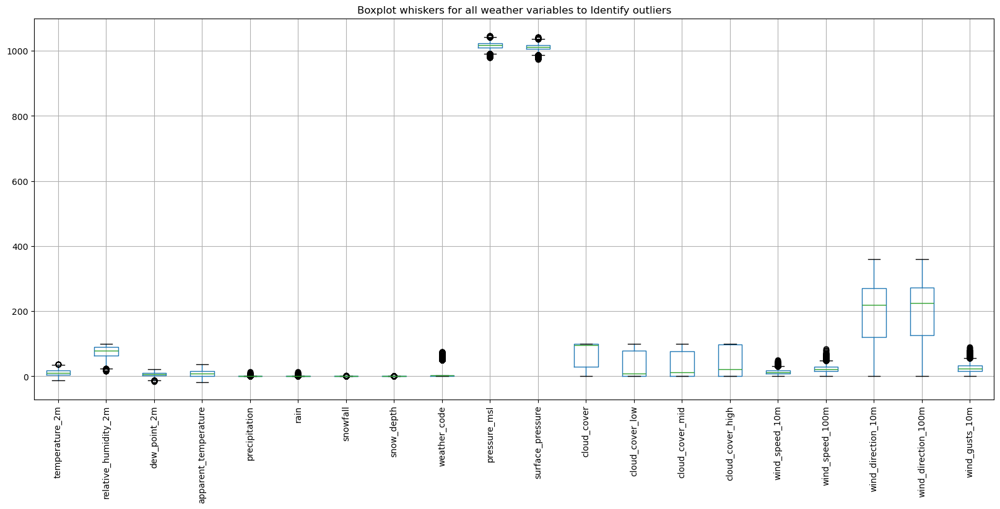

In [15]:
plt.figure(figsize=(20, 8))
weather_data.boxplot()
plt.title("Boxplot whiskers for all weather variables to Identify outliers")
plt.xticks(rotation = 90)
plt.show();

From the above visual we can see most columns have some extreme values, which is represented by the dark spots. Our data variables seem to be in different scale as we can see the size of the box whiskers are different. This is a good indication that we need to scale our data before applying any machine learning algorithm. The extreme data points can be accredited to occurrence of exorbitant weather conditions; maybe during different seasons throughout the year. We will keep them for now and do further analysis of each individual variable to understand it more.

### 1.4 SUMMARY STATISTICS
We will use the `describe()` function from pandas to get a summary of our data. This will give us the count, mean, standard deviation, min, 25%, 50%, 75 % and max of each variable. This will help us to understand the distribution of our data. 

In [16]:
#descriptive statistics
weather_data.describe()

,temperature_2m,relative_humidity_2m,dew_point_2m,apparent_temperature,precipitation,rain,snowfall,snow_depth,weather_code,pressure_msl,surface_pressure,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,wind_direction_100m,wind_gusts_10m
count,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000,35160.000000
mean,11.001529,75.210136,6.200259,8.391306,0.074605,0.070179,0.003106,0.003216,10.311604,1015.756104,1011.124146,68.206680,32.644569,34.365101,43.326962,13.484240,22.673500,197.469269,201.435303,25.442467
std,8.128738,17.476027,6.214458,9.514300,0.345978,0.341099,0.038204,0.012164,19.400906,9.799638,9.738913,39.259644,40.978104,40.122475,44.599857,6.547945,10.083346,91.556999,91.307182,11.852432
min,-13.191500,16.448080,-15.391500,-17.291695,0.000000,0.000000,0.000000,0.000000,0.000000,978.599976,974.142212,0.000000,0.000000,0.000000,0.000000,0.000000,0.360000,0.651045,0.415171,0.720000
25%,4.658500,63.573071,1.758500,0.705447,0.000000,0.000000,0.000000,0.000000,1.000000,1009.700012,1005.194092,29.000000,0.000000,0.000000,0.000000,8.534353,15.682225,120.338257,125.583925,16.559999
50%,10.408501,79.589073,6.308500,7.564425,0.000000,0.000000,0.000000,0.000000,3.000000,1016.200012,1011.613098,96.000000,8.000000,12.000000,22.000000,12.481153,22.065973,219.559631,224.916412,23.759998
75%,17.058500,89.633457,10.958500,15.844712,0.000000,0.000000,0.000000,0.000000,3.000000,1022.200012,1017.506897,100.000000,78.000000,77.000000,98.000000,17.339897,28.876396,270.000000,272.547577,32.399998
max,37.708500,100.000000,21.358500,36.522781,13.700000,13.700000,2.100000,0.110000,75.000000,1046.300049,1041.409424,100.000000,100.000000,100.000000,100.000000,49.743870,84.661255,360.000000,360.000000,89.279991


### 1.5 UNIVARIATE DATA ANALYSIS
On this section we are lookig at analysis of individual variables. This is the first step in the data analysis process. The goal of univariate analysis is to summarize the data and to identify the patterns and trends in the individual variables of the  data.

To get a better understanding and identify patterns we will set the date as the index of the dataframe and resample the data into daily mean. We will then use a loop to plot all the variables in order to seee their patterns independently.

In [17]:
#resetting index of the data
analysis_df  = weather_data.set_index("date")
#resample data to daily average
daily_df = analysis_df.resample("D").mean()
#resampling monthly average
monthly_df = analysis_df.resample("M").mean()

/tmp/ipykernel_194708/2900254906.py:6: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_df = analysis_df.resample("M").mean()


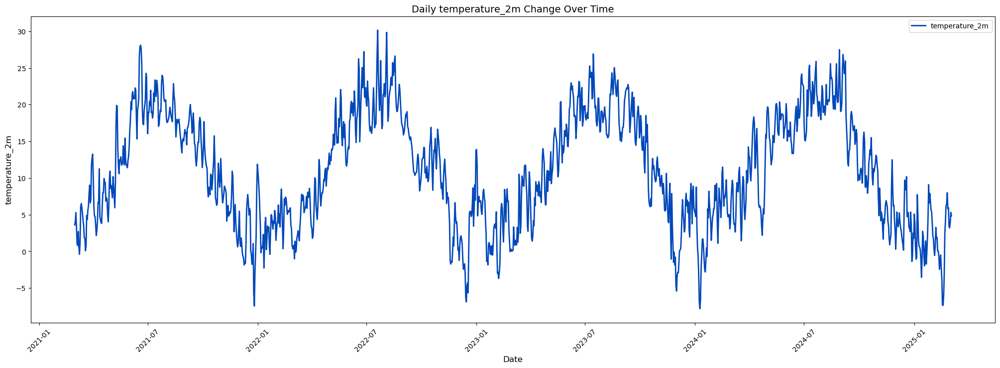

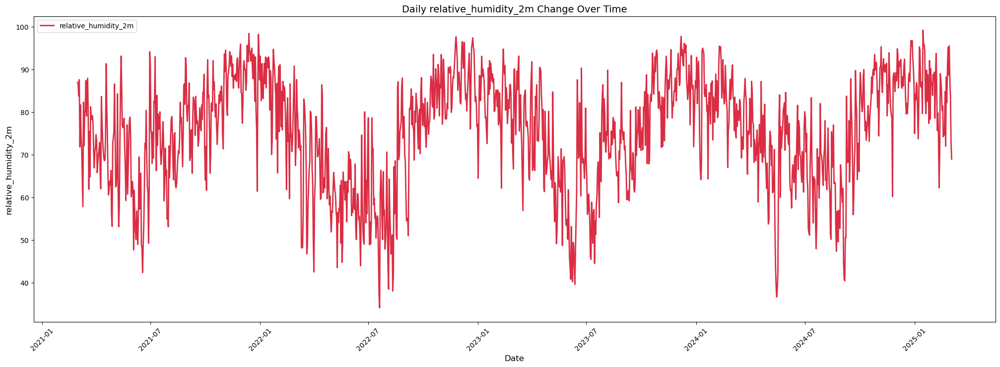

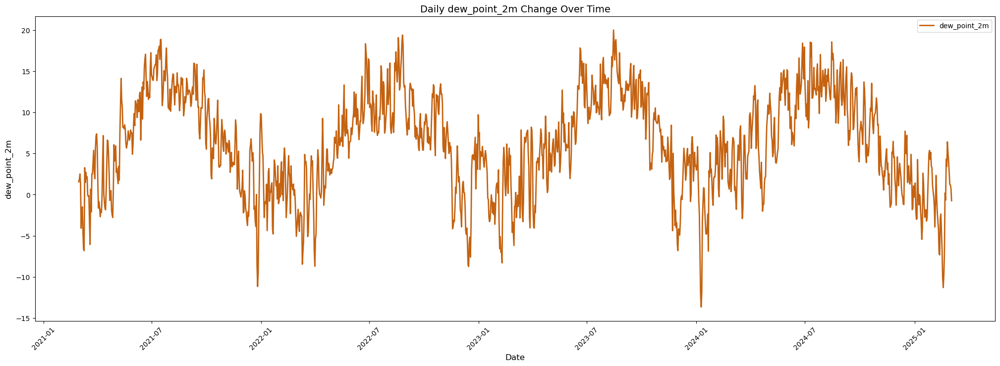

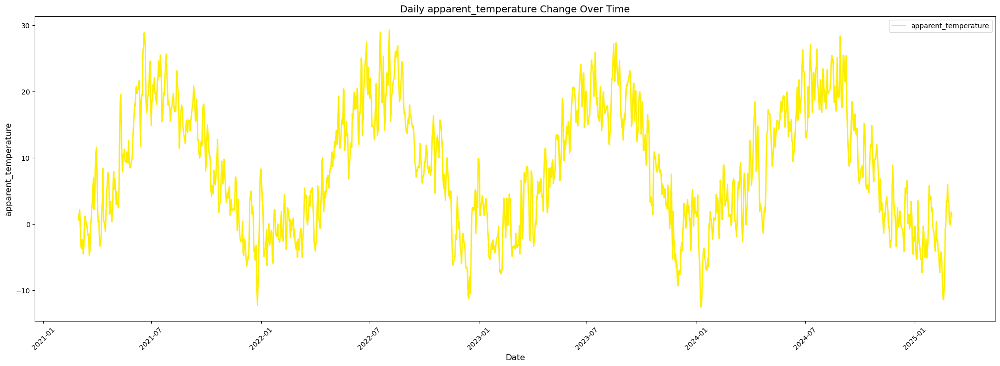

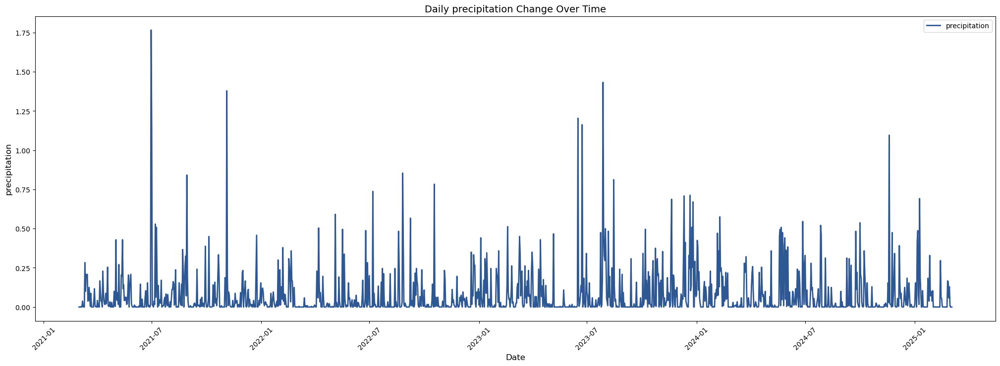

...

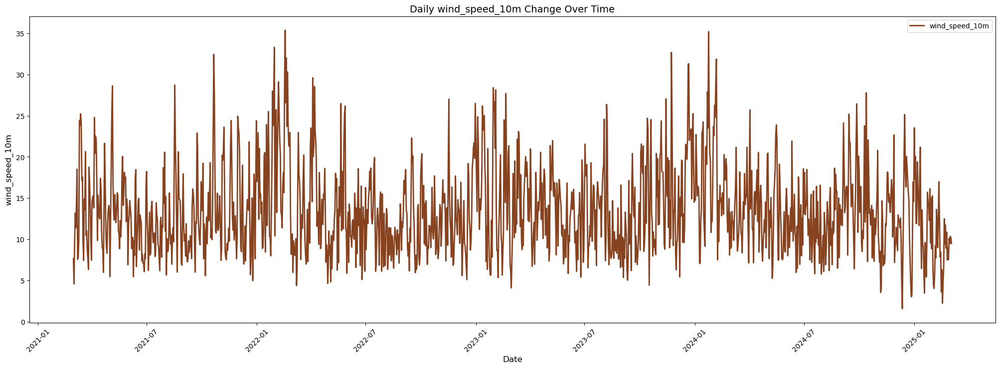

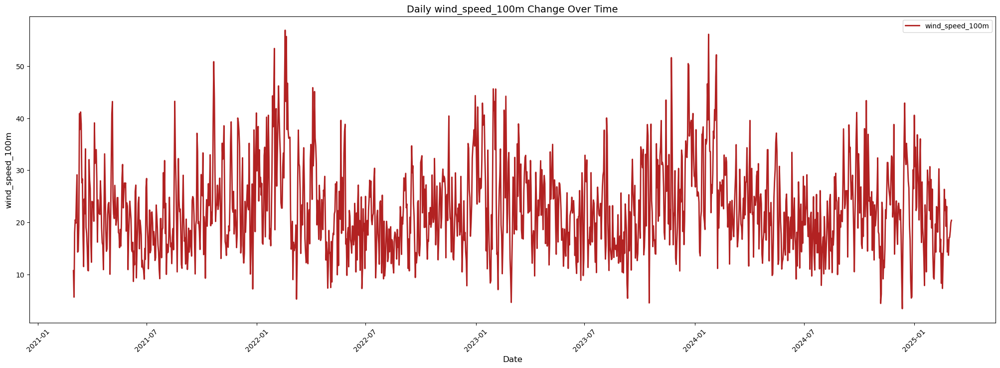

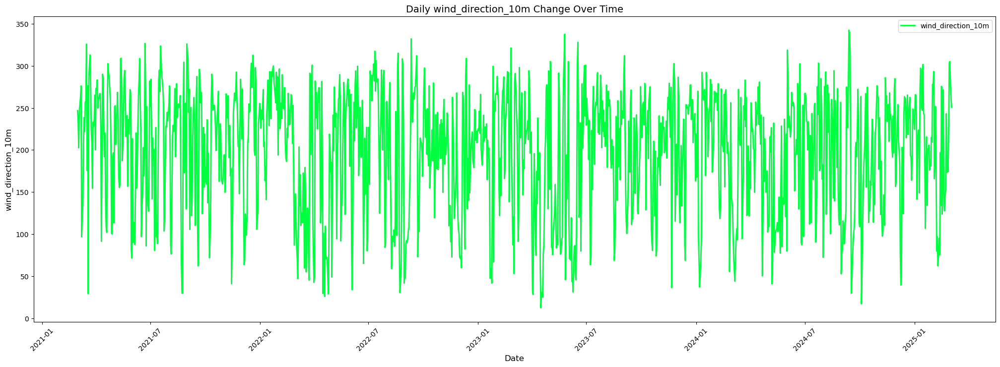

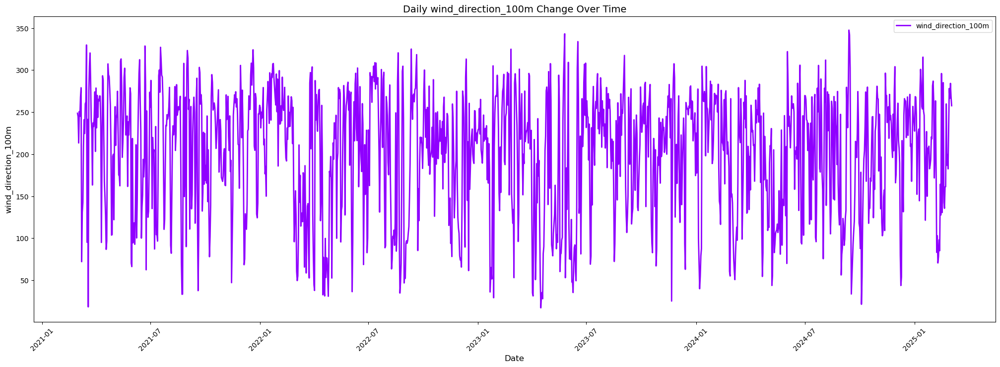

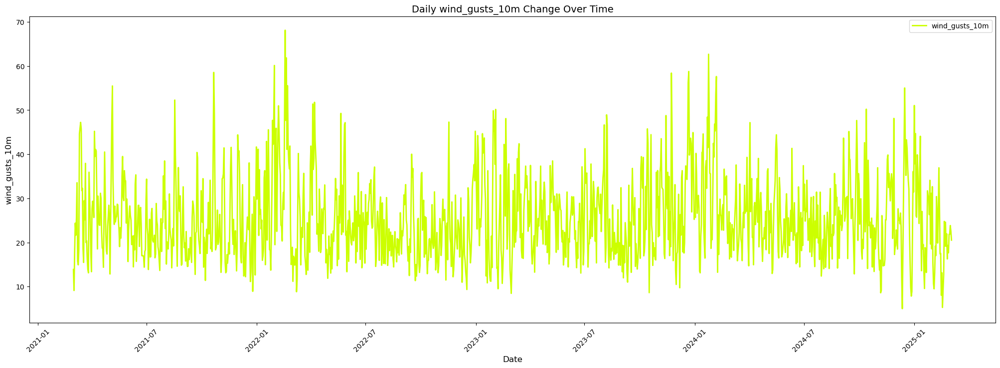

In [18]:
def line_plot():
    # Define custom colors (Ensuring enough colors for all columns)
    colors = ["#0048BA", "#DB2D43", "#C46210", "#FDEE00", "#2E5894", "#00FFFF", "#FF00FF", "#00FF00", "#0000FF", "#FF0000",
        "#000000", "#004225", "#80FF00", "#FF1493", "#1B1B1B", "#87421f", "#B22222", "#00FF40", "#8F00FF", "#CCFF00",
        "#00009C", "#B94E48", "#00CED1", "#3C1414", "#FF8C00", "#483C32", "#DC143C", "#FF3800", "#660000", "#72A0C1"]

    # Loop over columns and create a separate figure for each variable
    for i, col in enumerate(daily_df.columns):
        plt.figure(figsize=(25, 8))  # Separate figure for each plot
        color = colors[i % len(colors)]  # Assign a unique color for each variable
        plt.plot(daily_df.index, daily_df[col], color=color, label=col, linewidth=2)
        
        # Improve readability
        plt.title(f"Daily {col} Change Over Time", fontsize=14)
        plt.xlabel("Date", fontsize=12)
        plt.ylabel(col, fontsize=12)
        plt.legend()
        plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
        
        plt.show()  # Show each plot separately

# Call the function
line_plot()


### Brief explanation of the plots


### Plotly interactive dashboard
This interactive plot compliments the feature plots above. It allows you to select individual variable plots, and when you hover at any particular point, the `date`,  

In [19]:
# # # Ensure 'date' is in datetime format and set as index
# hourly_dataframe.index = pd.to_datetime(hourly_dataframe.index)

# # Resample data to daily mean (reduces noise in hourly data)
# daily_df = daily_df.reset_index()
# daily_df = pd.to_datetime(daily_df["date"])

# # Melt the DataFrame to long format for Plotly
# df_melted = daily_df.melt(id_vars=['date'], var_name='Weather Variable', value_name='Value')

# # Create interactive line plot
# fig = px.line(df_melted, x='date', y='Value', color='Weather Variable',
#         title="Interactive Weather Trends Over Time",
#         labels={'Value': 'Weather Metric', 'date': 'Date'},
#         hover_name='Weather Variable')

# # Improve interactivity:
# fig.update_traces(mode='lines+markers', marker=dict(size=4), hoverinfo='x+y+name')

# # Make legend and hover box scrollable
# fig.update_layout(
#     width=1200,  # Adjust width
#     height=700,  # Adjust height
#     hovermode="x unified",  # Show all values for a selected date
#     legend=dict(
#         title="Weather Variables",
#         traceorder="normal",
#         itemclick="toggleothers",  # Clicking isolates the selected variable
#         itemdoubleclick="toggle",  # Double-click to toggle individual visibility
#         yanchor="top",  # Anchors legend at the top
#         y=1.0,  # Keeps legend at the top
#         xanchor="left",
#         x=1.02,  # Moves legend outside the plot for better readability
#         bgcolor="rgba(255,255,255,0.7)",  # Semi-transparent background
#         bordercolor="black",
#         borderwidth=1,
#         font=dict(size=10),  # Adjust font size for readability
#     )
# )

# # Show interactive plot
# fig.show()


In [20]:
daily_df.columns

Index(['temperature_2m', 'relative_humidity_2m', 'dew_point_2m',
       'apparent_temperature', 'precipitation', 'rain', 'snowfall',
       'snow_depth', 'weather_code', 'pressure_msl', 'surface_pressure',
       'cloud_cover', 'cloud_cover_low', 'cloud_cover_mid', 'cloud_cover_high',
       'wind_speed_10m', 'wind_speed_100m', 'wind_direction_10m',
       'wind_direction_100m', 'wind_gusts_10m'],
      dtype='object')

### 1.6 BIVARIATE DATA ANALYSIS
Bivariate data analysis is an analysis technique used to analyze the relationship between two variables. If we look at the univariate plots above you will notice that some features have almost similar plots. It is possible that the features are related to each other and are communicating the same message. To understand that in depth, we will have to plot the features against each other.
#### 1.6.1 Temperature_2m and Apparrent temperature

In [21]:
def bivariate_plot(df, var1, var2):
    """
    Function to plot two variables on the same plot for bivariate analysis.
    
    Parameters:
    var1 (str): The first variable name (column) from daily_df.
    var2 (str): The second variable name (column) from daily_df.
    """
    
    plt.figure(figsize=(25, 7))  # Set figure size
    
    # Plot both variables
    plt.plot(df.index, df[var1], label=var1, color="blue", linewidth=2)
    plt.plot(df.index, df[var2], label=var2, color="red", linewidth=2)

    # Improve readability
    plt.title(f"Bivariate Analysis: {var1} vs {var2} Over Time", fontsize=14)
    plt.xlabel("Date", fontsize=12)
    plt.ylabel("Value", fontsize=12)
    plt.legend()
    plt.grid(True)
    plt.xticks(rotation=45)

    plt.show()

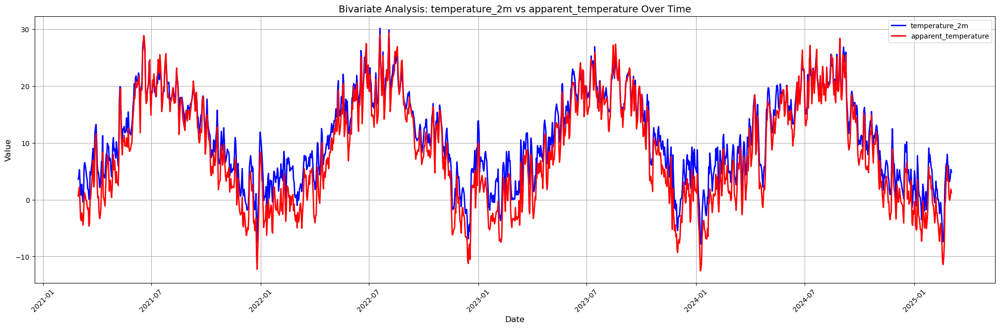

In [22]:
bivariate_plot(daily_df, "temperature_2m", "apparent_temperature")

The `temperature` and `apparent_temperature` seem to have the same pattern. Looking at the plot above, both features have almost the same pattern. This is not surprising since the apparent temperature is a function of the temperature. Apparent temperature is perceived as the feel like temperature, that is why we say it is a function of temperature and that can explain why they have the same pattern.
#### 1.6.2 Precipitaion and rain

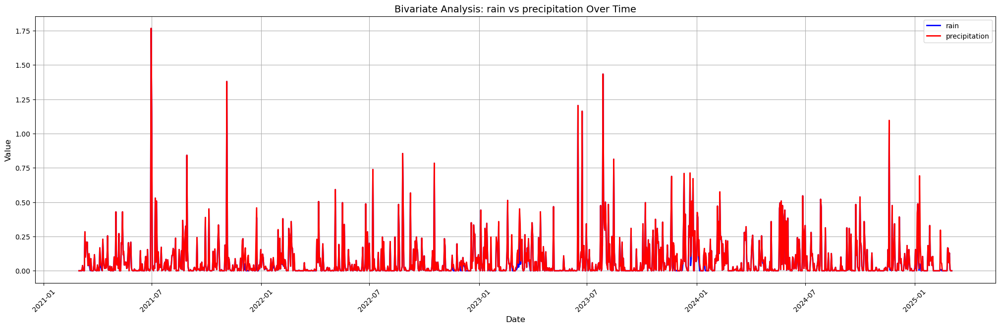

In [23]:
bivariate_plot(daily_df, "rain", "precipitation")

Looking at the above plot we can see raind and precipitaion have an almost similar pattern. While rain means only liquid water droplets, precipitation includes both liquid and solid forms of water like hail or ice. With the above visual we can say there is a perfect correlation between rain and precipitaion; when there is rain, there is also precipitation and vice versa.
### 1.6.2 Snowfall and snow_depth


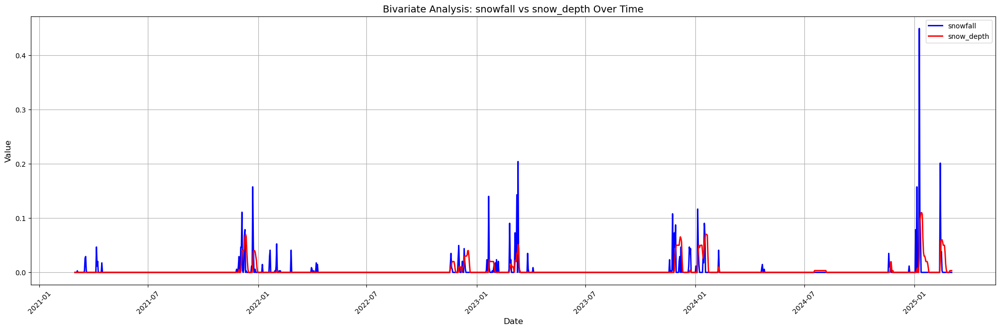

In [24]:
bivariate_plot(daily_df, "snowfall", "snow_depth")

Even though not that similar, snowfall and snow depth seem to go hand in hand with each other. The more snowfall, the more snow depth. However, the relationship is not that straightforward. Snow depth is also influenced by factors such as temperature, wind, and the type of snow. For example, if the temperature is too warm, the snow may melt and reduce the snow depth. If the wind is strong, it can blow the snow away and reduce the snow depth. If the snow is powdery, it may not pack down as much as wetter snow, resulting in a lower snow depth. Therefore, snow depth is not always directly proportional to snowfall.
### 1.6.3 Pressure_msl and Surface_pressure

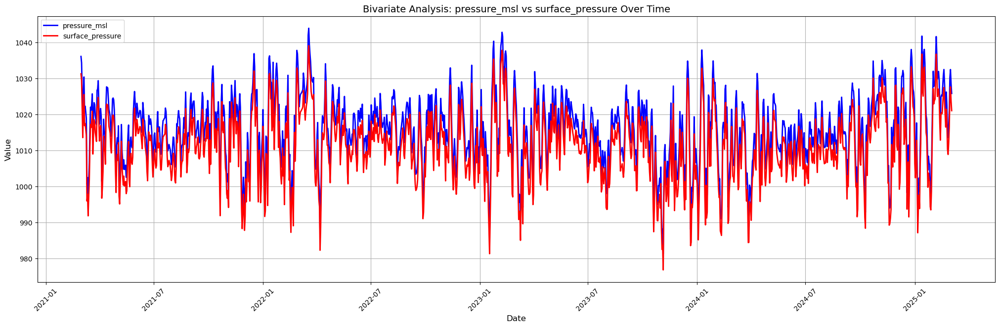

In [25]:
bivariate_plot(daily_df, "pressure_msl", "surface_pressure")

Pressure_msl and surface pressure seem to have a similar pattern. The difference between the two is that the surface pressure tends to  change with difference in elevation while pressure_msl is constant at sea level. The pressure_msl is the pressure at sea level and is used as a reference point for all other pressure values. Using surface pressure is not advisable as it is prone to errors due to elevation changes.
### 1.6.4 Relative humidity_2m vs dew_point_2m

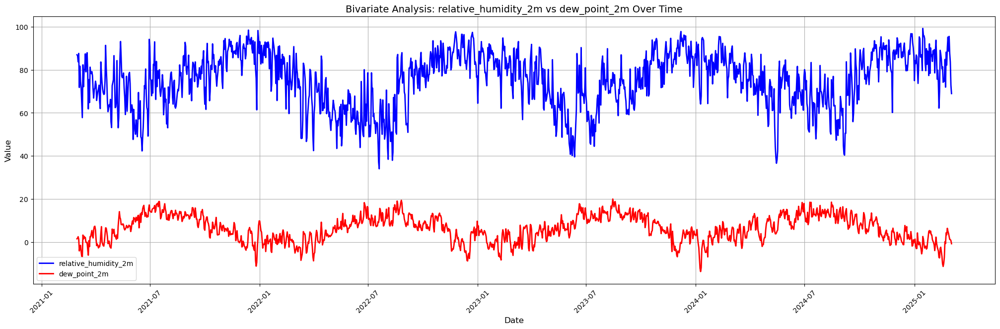

In [26]:
bivariate_plot(daily_df, "relative_humidity_2m", "dew_point_2m")

#### 1.7 MULTIVARIATE DATA  ANALYSIS
In this SECTION, we will look at  the analysis of multivariate data. Multivariate data analysis is an analysis  technique that involves the analysis of data that has more than one variable. FOr this part we will display plots like `scatter plots` and `correlation heatmap`

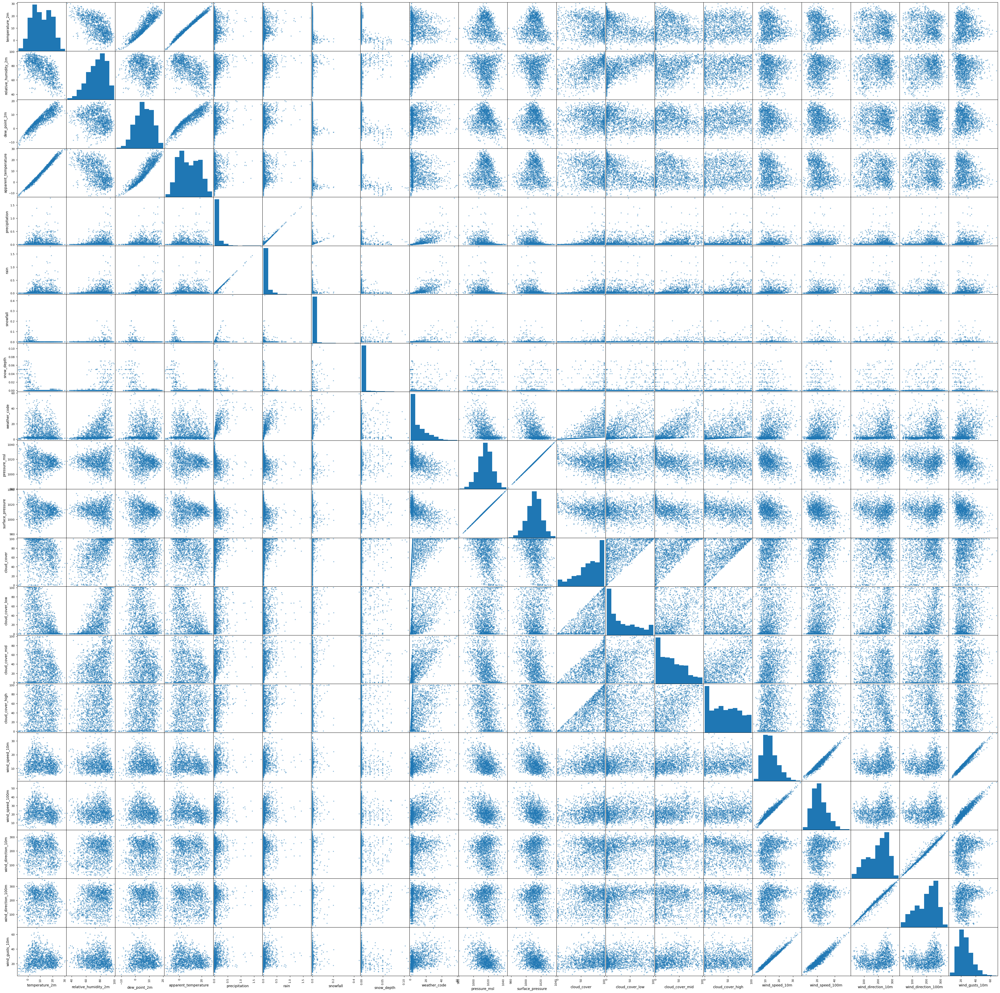

In [28]:
#scattte plots for each feature
pd.plotting.scatter_matrix(daily_df, figsize=(50, 50))
plt.xticks(rotation = 90)
plt.yticks(rotation = 45)
plt.show();

With the above visual we can see that some features have a linear relationship while some have a non-linear relationship. This is important to us since it helps us understand how the features are related to each other and how it impacts our analysis and modelling when we merge the weather data and the traffic data. We can use this information to decide which features to use in our model.
#### Corrrelation heatmap

<Axes: >

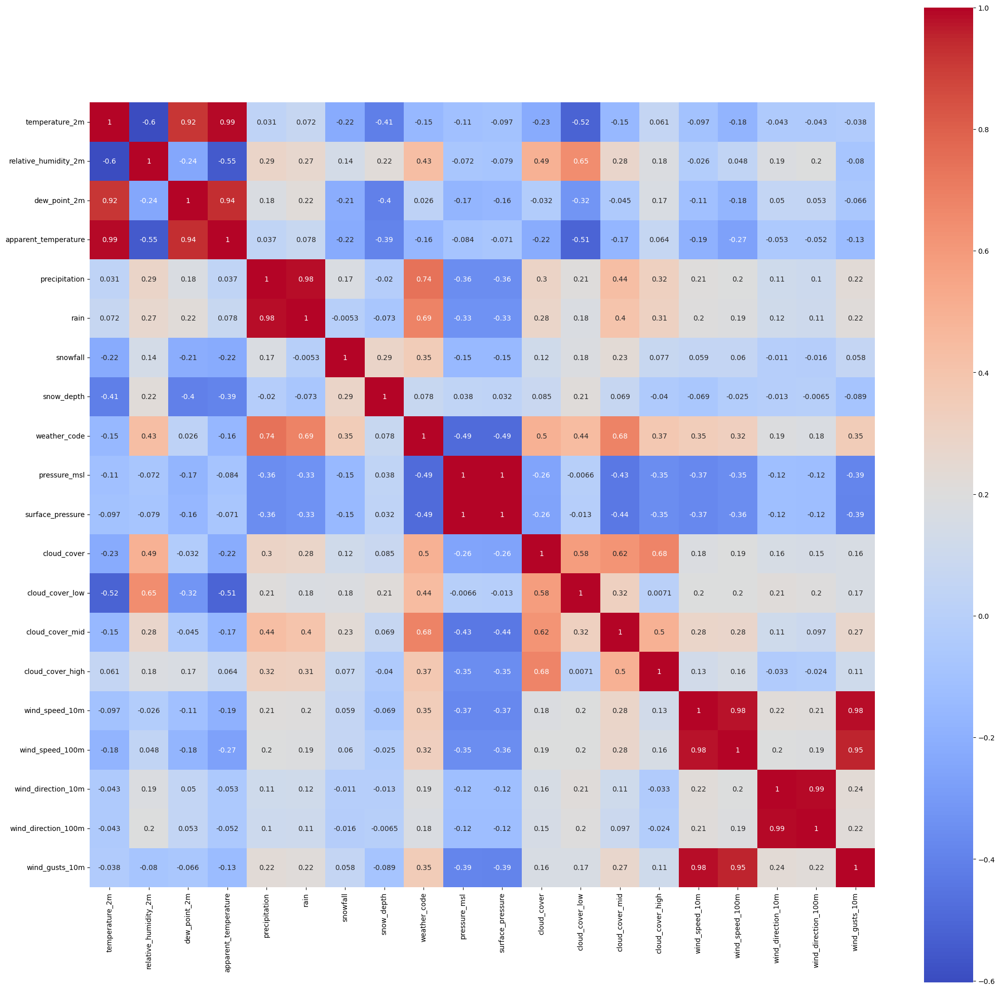

In [33]:
#calculating correlation
corr =  daily_df.corr()
#plot the corr heatmap
plt.figure(figsize=(25, 25))
sns.heatmap(corr,  annot=True, cmap='coolwarm', square=True)

The correlation heatmap is just a complimentary plot to the scatter plot. It shows the correlation between each pair of variables. The color of the cell in the heatmap represents the correlation coefficient. The color bar on the right side of the heatmap shows the color mapping. The correlation coefficient ranges from -1 to 1. A correlation coefficient of 1 means a perfect positive correlation, a correlation coefficient of -1 means a perfect negative correlation, and a correlation coefficient of 0 means no correlation.

Looking at some of the bivariate plots, i.e  rain and precipitation, we saw that there was a strong positive correlation and this is evident in the correlation heatmap as we can see the correlation coefficient is 0.98 which is very close to 1.